In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error,mean_squared_log_error

In [2]:
#Preparatory functions

import warnings
warnings.filterwarnings("ignore")

sns.set_style("darkgrid")

from IPython.display import Markdown, display, HTML
def printmd(string):
    display(Markdown(string))

def prin(DataFrame):
    with pd.option_context('display.max_rows', 8,
                        'display.max_columns', None,
                        'display.width', 1000,
                        'display.precision', 3,
                        'display.colheader_justify', 'center'):
                        display(DataFrame)

def normalize(df):
    result = df.copy()
    exc = ["Year","year","name","release_date"]
    for feature_name in df.columns:
        if feature_name not in exc:
            # Min-Max Scale If it Is Not the Year Column
            print(feature_name)
            max_value = df[feature_name].max()
            min_value = df[feature_name].min()
            result[feature_name] = (df[feature_name] - min_value) / (max_value - min_value)
    return result


In [3]:
global df
df=pd.read_csv("tracks.csv")
fd=pd.read_csv("artists.csv")


prin(df)
fd.tail(10)

,id,name,popularity,duration_ms,explicit,artists,id_artists,release_date,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
0,35iwgR4jXetI318WEWsa1Q,Carve,6,126903,0,['Uli'],['45tIt06XoI0Iio4LBEVpls'],1922-02-22,0.645,0.445,0,-13.338,1,0.451,0.674,7.440e-01,0.151,0.127,104.851,3
1,021ht4sdgPcrDgSk7JTbKY,Capítulo 2.16 - Banquero Anarquista,0,98200,0,['Fernando Pessoa'],['14jtPCOoNZwquk5wd9DxrY'],1922-06-01,0.695,0.263,0,-22.136,1,0.957,0.797,0.000e+00,0.148,0.655,102.009,1
2,07A5yehtSnoedViJAZkNnc,Vivo para Quererte - Remasterizado,0,181640,0,['Ignacio Corsini'],['5LiOoJbxVSAMkBS2fUm3X2'],1922-03-21,0.434,0.177,1,-21.180,1,0.051,0.994,2.180e-02,0.212,0.457,130.418,5
3,08FmqUhxtyLTn6pAh6bk45,El Prisionero - Remasterizado,0,176907,0,['Ignacio Corsini'],['5LiOoJbxVSAMkBS2fUm3X2'],1922-03-21,0.321,0.095,7,-27.961,1,0.050,0.995,9.180e-01,0.104,0.397,169.980,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
586668,0NuWgxEp51CutD2pJoF4OM,blind,72,153293,0,['ROLE MODEL'],['1dy5WNgIKQU6ezkpZs4y8z'],2020-10-21,0.765,0.663,0,-5.223,1,0.065,0.141,2.970e-04,0.092,0.686,150.091,4
586669,27Y1N4Q4U3EfDU5Ubw8ws2,What They'll Say About Us,70,187601,0,['FINNEAS'],['37M5pPGs6V1fchFJSgCguX'],2020-09-02,0.535,0.314,7,-12.823,0,0.041,0.895,1.500e-04,0.087,0.066,145.095,4
586670,45XJsGpFTyzbzeWK8VzR8S,A Day At A Time,58,142003,0,"['Gentle Bones', 'Clara Benin']","['4jGPdu95icCKVF31CcFKbS', '5ebPSE9YI5aLeZ1Z2g...",2021-03-05,0.696,0.615,10,-6.212,1,0.035,0.206,2.530e-06,0.305,0.438,90.029,4
586671,5Ocn6dZ3BJFPWh4ylwFXtn,Mar de Emociones,38,214360,0,['Afrosound'],['0i4Qda0k4nf7jnNHmSNpYv'],2015-07-01,0.686,0.723,6,-7.067,1,0.036,0.105,0.000e+00,0.264,0.975,112.204,4


,id,followers,genres,name,popularity
1162085,4JLYIWkIU0p2zxtTaixtoC,328.0,"['deep comedy', 'new comedy']",Gabriel Rutledge,14
1162086,6fulEar0uOeRNYLp7RvaKg,1598.0,"['deep comedy', 'new comedy']",Joe Zimmerman,27
1162087,0vZbvoyHDSwTGY4v1oUo31,1682.0,"['clean comedy', 'deep comedy', 'new comedy']",Josh Sneed,20
1162088,3V4ODgUObsEHFX6GQUy8xl,419.0,['deep comedy'],Matt McCarthy,9
1162089,2AuW39AOSXtNdQP6thlLgi,188.0,[],Ty Barnett,3
1162090,3cOzi726Iav1toV2LRVEjp,4831.0,['black comedy'],Ali Siddiq,34
1162091,6LogY6VMM3jgAE6fPzXeMl,46.0,[],Rodney Laney,2
1162092,19boQkDEIay9GaVAWkUhTa,257.0,[],Blake Wexler,10
1162093,5nvjpU3Y7L6Hpe54QuvDjy,2357.0,['black comedy'],Donnell Rawlings,15
1162094,2bP2cNhNBdKXHC6AnqgyVp,40.0,['new comedy'],Gabe Kea,8


###     Potential Problem Statements
- #### Q) What makes a song popular
- #### Q) Feature Change over time


~~Q) Predict what songs could be popular (reccommendation)
Q) What kind of artists make hit songs?
Q) Famous Outliers~~



<h2>Exploratory

In [4]:
xdf=df.copy()
xdf=xdf.drop(columns=["id","id_artists","explicit","time_signature"])

In [5]:
xdf.sort_values(by="popularity",ascending=False)

,name,popularity,duration_ms,artists,release_date,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo
93802,Peaches (feat. Daniel Caesar & Giveon),100,198082,"['Justin Bieber', 'Daniel Caesar', 'Giveon']",2021-03-19,0.677,0.6960,0,-6.181,1,0.1190,0.3210,0.000000,0.420,0.464,90.030
93803,drivers license,99,242014,['Olivia Rodrigo'],2021-01-08,0.585,0.4360,10,-8.761,1,0.0601,0.7210,0.000013,0.105,0.132,143.874
93804,Astronaut In The Ocean,98,132780,['Masked Wolf'],2021-01-06,0.778,0.6950,4,-6.865,0,0.0913,0.1750,0.000000,0.150,0.472,149.996
92810,Save Your Tears,97,215627,['The Weeknd'],2020-03-20,0.680,0.8260,0,-5.487,1,0.0309,0.0212,0.000012,0.543,0.644,118.051
92811,telepatía,97,160191,['Kali Uchis'],2020-12-04,0.653,0.5240,11,-9.016,0,0.0502,0.1120,0.000000,0.203,0.553,83.970
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23410,O Pardesi Musafir,0,198053,"['Suraiya', 'Lata Mangeshkar']",1949-01-01,0.682,0.3050,1,-8.558,1,0.0578,0.9240,0.000000,0.119,0.910,152.850
23409,Mere Dil Mein Aao Aur Bas Jao,0,171133,['Suraiya'],1949-01-01,0.527,0.2030,7,-14.199,1,0.0667,0.9900,0.000012,0.129,0.688,170.733
23408,"Diversions, Op. 21: Variation 9, Toccata I",0,46720,"['Benjamin Britten', 'Leon Fleisher', 'Seiji O...",1949,0.441,0.2420,6,-28.776,1,0.0323,0.9290,0.955000,0.116,0.528,132.060
23407,John Henry,0,189973,['Lead Belly'],1949,0.593,0.7480,2,-6.514,0,0.4060,0.8880,0.021800,0.680,0.732,123.634


In [6]:
xdf.dtypes
xdf['Year'] = pd.to_datetime(xdf['release_date'], format='%Y-%m-%d')
xdf['year'] = pd.to_datetime(xdf['Year'],errors='coerce').dt.year

In [7]:
xdf

,name,popularity,duration_ms,artists,release_date,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,Year,year
0,Carve,6,126903,['Uli'],1922-02-22,0.645,0.4450,0,-13.338,1,0.4510,0.674,0.744000,0.1510,0.1270,104.851,1922-02-22,1922
1,Capítulo 2.16 - Banquero Anarquista,0,98200,['Fernando Pessoa'],1922-06-01,0.695,0.2630,0,-22.136,1,0.9570,0.797,0.000000,0.1480,0.6550,102.009,1922-06-01,1922
2,Vivo para Quererte - Remasterizado,0,181640,['Ignacio Corsini'],1922-03-21,0.434,0.1770,1,-21.180,1,0.0512,0.994,0.021800,0.2120,0.4570,130.418,1922-03-21,1922
3,El Prisionero - Remasterizado,0,176907,['Ignacio Corsini'],1922-03-21,0.321,0.0946,7,-27.961,1,0.0504,0.995,0.918000,0.1040,0.3970,169.980,1922-03-21,1922
4,Lady of the Evening,0,163080,['Dick Haymes'],1922,0.402,0.1580,3,-16.900,0,0.0390,0.989,0.130000,0.3110,0.1960,103.220,1922-01-01,1922
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
586667,云与海,50,258267,['阿YueYue'],2020-09-26,0.560,0.5180,0,-7.471,0,0.0292,0.785,0.000000,0.0648,0.2110,131.896,2020-09-26,2020
586668,blind,72,153293,['ROLE MODEL'],2020-10-21,0.765,0.6630,0,-5.223,1,0.0652,0.141,0.000297,0.0924,0.6860,150.091,2020-10-21,2020
586669,What They'll Say About Us,70,187601,['FINNEAS'],2020-09-02,0.535,0.3140,7,-12.823,0,0.0408,0.895,0.000150,0.0874,0.0663,145.095,2020-09-02,2020
586670,A Day At A Time,58,142003,"['Gentle Bones', 'Clara Benin']",2021-03-05,0.696,0.6150,10,-6.212,1,0.0345,0.206,0.000003,0.3050,0.4380,90.029,2021-03-05,2021


For the sake of processing power we will perform on last lakh records

In [8]:
xdf=xdf.sort_values('Year')
xdf=xdf[-100000:]
lines = ["acousticness","loudness","energy", "valence",'instrumentalness','liveness','danceability']

In [ ]:
%%script false --no-raise-error


plt.figure(figsize=(14,8))
plt.title("Four Most Popular Features' Trend Over Time", fontdict={"fontsize": 15})

lines = ["acousticness","loudness","energy", "valence",'instrumentalness','liveness','danceability']
# for line in tqdm(lines,position=0, desc="Loading:", leave=False, colour='green', ncols=80):

for line in tqdm(lines,position=0, desc="Loading:", leave=False, colour='green', ncols=80):
    ax = sns.lineplot(x='Year', y=line, data=xdf, errorbar=("ci", False))

plt.ylabel("value")
plt.legend(lines)


In [ ]:
import plotly.express as px 
%time

#for line in tqdm(lines,position=0, desc="Loading:", leave=False, colour='green', ncols=80):
fig = px.line(xdf, x="Year", y=lines,title="Features of Songs")
fig.show()


CPU times: total: 0 ns
Wall time: 0 ns


Do any of these directly affect popularity?
- Left with respect to <b>Years</b>
- Right with respect to <b>Popularity</b>

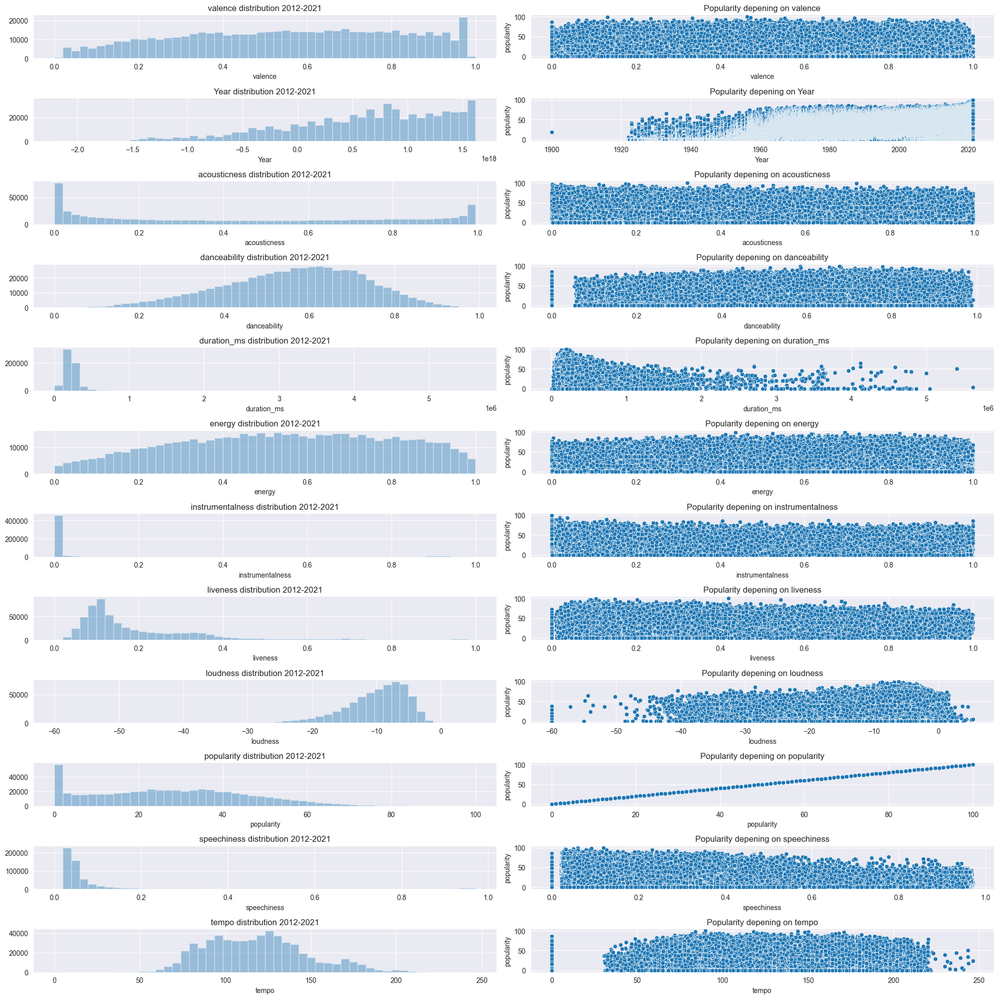

In [11]:
plt.figure(figsize=(20,20))
count=1
xy_columns = ['valence', 'Year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'instrumentalness', 'liveness', 'loudness', 'popularity', 'speechiness', 'tempo']
x_columns = ['valence', 'Year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo']

for xvar in xy_columns:
    plt.subplot(12,2, count);
    count += 1
    plt.gca().set_title(xvar + ' distribution 2012-2021')
    sns.distplot(a=xdf[xvar], kde=False)
    plt.subplot(12,2,count)
    count +=1
    plt.gca().set_title('Popularity depening on ' + xvar)
    sns.scatterplot(x=xdf[xvar], y=xdf.popularity)
    #sns.kdeplot(data=data_num[[xvar, 'popularity']], hue="kind", fill=True)
    #mean_df = df.groupby([xvar])['popularity'].mean().to_frame().reset_index()
    #sns.scatterplot(x=mean_df[xvar], y=mean_df.popularity, data=mean_df)

#plt.subplots_adjust(space = 0.5)
plt.tight_layout()

- While LHS gives us some insight
- The correlation with RHS is weak in most cases
- Outliers hold impact in some areas
- Data still isnt pre processed

### Checking for Null values

Since our target variable is popularity, we can remove all songs that have 0 popularity

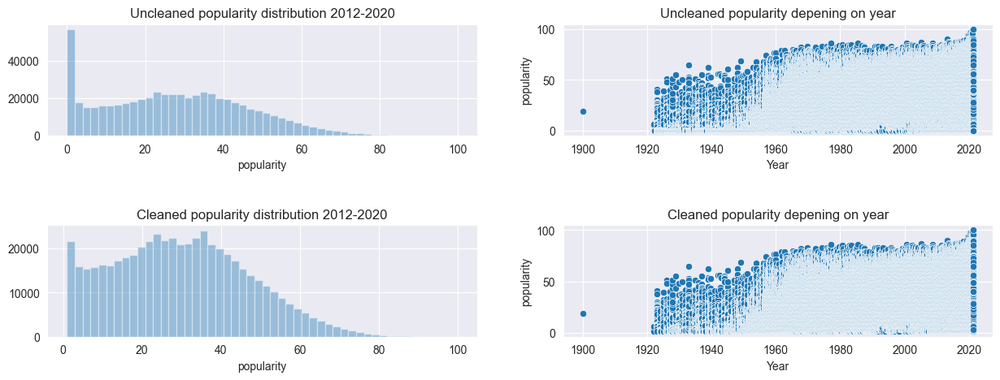

In [9]:
# Let's remove 0 values rows for popularity
xdfp = xdf[xdf['popularity'] !=0]

# Popularity uncleaned
plt.figure(figsize=(15,5))
plt.subplot(2,2,1)
plt.gca().set_title('Uncleaned popularity distribution 2012-2020')
sns.distplot(a=xdf.popularity, kde=False)
plt.subplot(2,2,2)
plt.gca().set_title('Uncleaned popularity depening on year')
sns.scatterplot(x=xdf.Year, y=xdf.popularity)

# Popularity cleaned
plt.subplot(2,2,3)
plt.gca().set_title('Cleaned popularity distribution 2012-2020')
sns.distplot(a=xdfp.popularity, kde=False)
plt.subplot(2,2,4)
plt.gca().set_title('Cleaned popularity depening on year')
sns.scatterplot(x=xdfp.Year, y=xdfp.popularity)
plt.subplots_adjust(hspace = 0.8)

After removing 0 popularity songs, distribution has slightly improved, but not significantly, But its not as if the popularity was 0 because there was data missing
hence we will proceed with the original dataset

In [12]:
# Proportion of 0 for x_columns
for col in x_columns:
    print('Zeroes in', col,': ', round((len(xdf)- np.count_nonzero(xdf[col], axis=0))/len(xdf)*100,2), '%')

Zeroes in valence :  0.06 %
Zeroes in Year :  0.49 %
Zeroes in acousticness :  0.01 %
Zeroes in danceability :  0.06 %
Zeroes in duration_ms :  0.0 %
Zeroes in energy :  0.01 %
Zeroes in instrumentalness :  34.96 %
Zeroes in liveness :  0.01 %
Zeroes in loudness :  0.0 %
Zeroes in speechiness :  0.06 %
Zeroes in tempo :  0.06 %


In [13]:
#Really zero values

print("Is it 0 when tempo is 0?")
for col in x_columns:
    
    print( str(col)+': ' + str(xdf[xdf['tempo']==0].equals(xdf[xdf[col]==0])))

Is it 0 when tempo is 0?
valence: False
Year: False
acousticness: False
danceability: True
duration_ms: False
energy: False
instrumentalness: False
liveness: False
loudness: False
speechiness: False
tempo: True


In [14]:
# Find some examples (most popular ones) of zero tempo songs
data_zero_tempo = xdf[xdf['tempo'] ==0].sort_values(by='popularity', ascending=False)
printmd('***# of songs with 0 bpm:*** ' + str(data_zero_tempo.shape[0]))
printmd('***Examples for 0 bpm songs:***')
display(data_zero_tempo[['name', 'artists', 'Year', 'tempo', 'speechiness', 'danceability', 'popularity']].head(10))


xdf=xdf[~xdf["name"].isin(data_zero_tempo.name)]

***# of songs with 0 bpm:*** 328

***Examples for 0 bpm songs:***

,name,artists,Year,tempo,speechiness,danceability,popularity
89913,Clean White Noise - Loopable with no fade,"['Erik Eriksson', 'White Noise Baby Sleep', 'W...",2017-01-08,0.0,0.0,0.0,86
90054,White Noise - 500 hz,['Granular'],2017-10-13,0.0,0.0,0.0,78
90104,White Noise - 145 hz,['Granular'],2017-10-13,0.0,0.0,0.0,77
91234,Soft Brown Noise,['High Altitude Samples'],2018-11-15,0.0,0.0,0.0,76
115632,Deep Sleep Recovery Noise,['Water Sound Natural White Noise'],2020-02-25,0.0,0.0,0.0,75
88262,Brown Noise - Loopable with No Fade,"['White Noise Meditation', 'Lullaby Land', 'Wh...",2015-05-26,0.0,0.0,0.0,72
119442,White Noise Crashing Waves,['Bruce Brus'],2019-08-09,0.0,0.0,0.0,72
90578,Pure Brown Noise - Loopable with no fade,"['Erik Eriksson', 'White Noise for Babies', 'W...",2017-01-08,0.0,0.0,0.0,72
177682,Clean & Pure White Noise,['Zenibly'],2018-08-01,0.0,0.0,0.0,70
89518,Box Fan Rest Sound,['Fan Sounds'],2016-11-11,0.0,0.0,0.0,69


These soundtracks are popular because it seems to have a positive effect and helps achieve deep sleep or even for relaxation. 
- Albeit popular it doesnt align with our problem statement
- These will be removed

### Relation with Mean of Popularity
- LHS is same as before
- But we compare mean of popularity instead of popularity directly

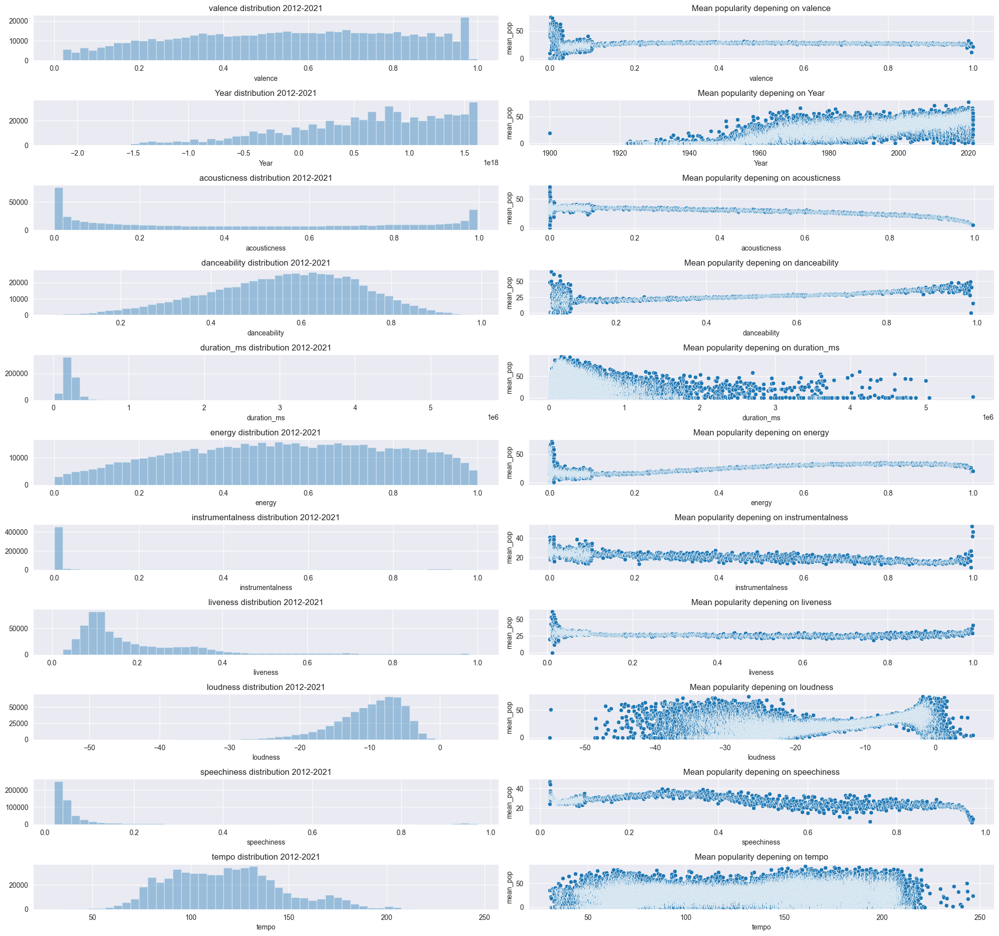

In [15]:
plt.figure(figsize=(20,20))
count=1

for xvar in x_columns:
    plt.subplot(12,2, count)
    count += 1
    plt.gca().set_title(xvar + ' distribution 2012-2021')
    sns.distplot(a=xdf[xvar], kde=False)
    plt.subplot(12,2,count)
    count +=1
    plt.gca().set_title('Mean popularity depening on ' + xvar)

    mean_df = xdf.groupby([xvar])['popularity'].mean().to_frame().reset_index()
    mean_df['mean_pop'] = mean_df['popularity']
    sns.scatterplot(x=mean_df[xvar], y=mean_df.mean_pop)

plt.subplots_adjust()
plt.tight_layout()

### We can see some linear and non linear trends for popularity

With respect to Mean popularity

When value is low |  When its distributed | When value is high
--------- | ------- | -------
valence | danceability | Year
liveness  | energy | loudness
acousticness | Instrumentalness |
duration | tempo |
Speechiness






In [16]:
year_avg = xdf[["acousticness","danceability","energy", "instrumentalness", 
               "liveness","tempo", "valence", "loudness", "speechiness", "year"]].groupby("year").mean().sort_values(by="year").reset_index()

tdf = xdf[["acousticness","danceability","energy", "instrumentalness", 
               "liveness","tempo", "valence", "loudness", "speechiness", "year","Year"]].sort_values(by="year").reset_index()

year_avg.head(15)

,year,acousticness,danceability,energy,instrumentalness,liveness,tempo,valence,loudness,speechiness
0,1900,0.139000,0.659000,0.791000,0.000002,0.161000,141.999000,0.956000,-4.895000,0.029500
1,1922,0.898857,0.533320,0.324054,0.324971,0.250670,109.120405,0.563605,-13.953241,0.246295
2,1923,0.859965,0.637332,0.266977,0.157659,0.225396,109.552648,0.671967,-16.351921,0.552072
3,1924,0.865441,0.596620,0.358197,0.336102,0.203592,119.897959,0.557534,-13.227479,0.377512
4,1925,0.924455,0.625706,0.267301,0.279093,0.258593,115.435071,0.643751,-14.371232,0.309810
5,1926,0.785739,0.622113,0.263075,0.323416,0.211447,113.386792,0.539702,-15.929906,0.356952
6,1927,0.906253,0.650711,0.280463,0.270478,0.182666,110.949869,0.680102,-15.282031,0.366843
7,1928,0.940075,0.542242,0.244461,0.453343,0.175056,109.246456,0.524054,-15.836494,0.148623
8,1929,0.954420,0.603243,0.319018,0.364263,0.191097,118.613363,0.645757,-11.531437,0.104317
9,1930,0.925013,0.530138,0.331717,0.327918,0.221316,111.452722,0.594141,-12.952725,0.126294


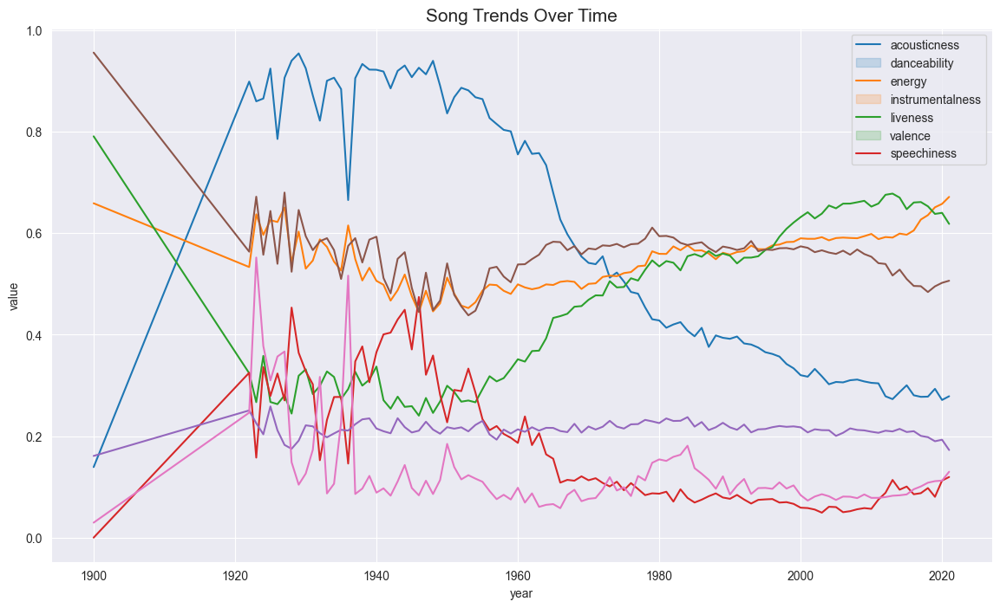

In [17]:
plt.figure(figsize=(14,8))
plt.title("Song Trends Over Time", fontdict={"fontsize": 15})

#without Loudness
lines = ["acousticness","danceability","energy", 
         "instrumentalness", "liveness", "valence", "speechiness"]


for line in lines:
    ax = sns.lineplot(x='year', y=line, data=year_avg)
    
    
plt.ylabel("value")
plt.legend(lines)

#### Check for relationship between Features

<Axes: >

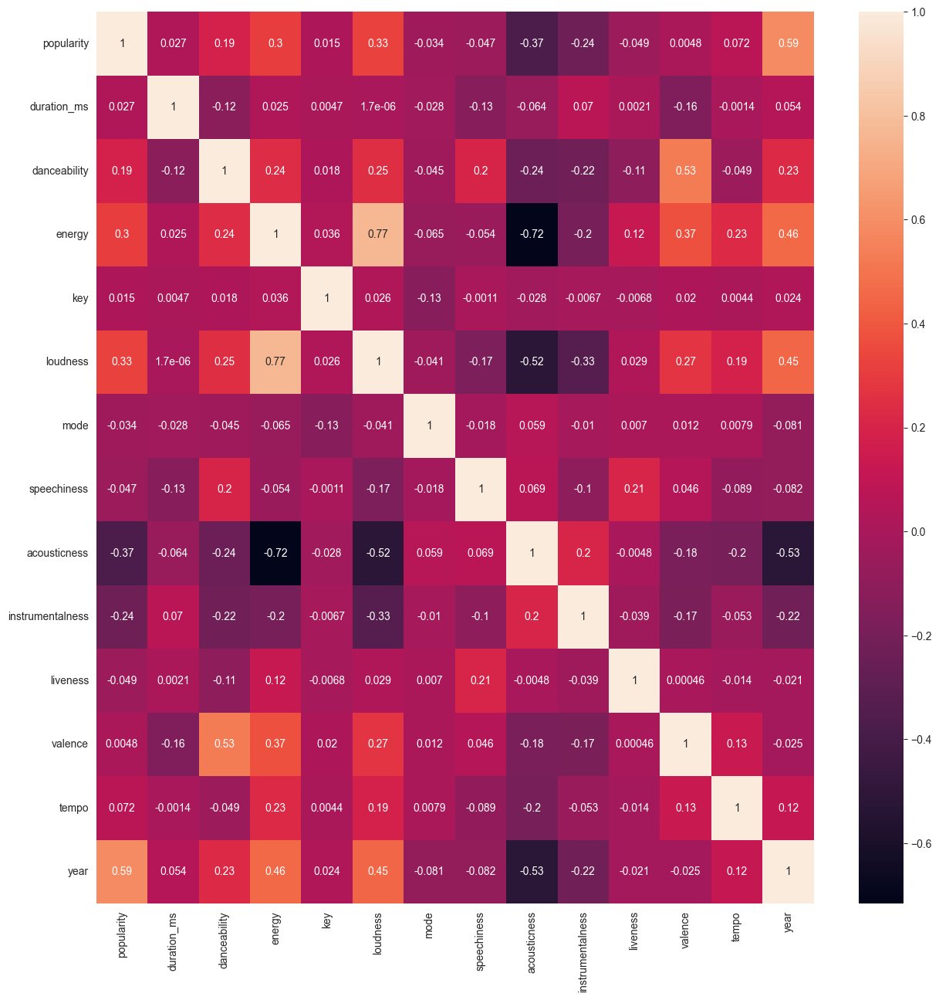

In [18]:
# Looking at correlations
plt.figure(figsize = (15,15)) #creating the 'canvas'
sns.heatmap(xdf.corr(), annot=True)

#### Insights
- acousticness: correlated also negatively with loudness, energy and danceability and year
- instrumentalness: similar (but less signal) to acousticness correlates also negatively with loudness, energy and danceability and year)


#### Positive Influence to popularity
- year 
- energy
- loudness
- danceability

Year Might signify the effect of social Media on songs

### Prepare Data

In [40]:
#Lets Run a simple Linear Regression with popularity as target

train, test = train_test_split(xdf, test_size=0.3, shuffle=False)
#danceability
training_features = ["acousticness","danceability","energy", "instrumentalness", 
               "liveness","tempo", "valence", "loudness", "speechiness","year"]
target = 'popularity'
train_X = train[training_features]
train_Y = train[target]
test_X = test[training_features]
test_Y = test[target]

### Run Initial Model  

In [27]:
#Model with 0 Tuning
mn = "Linear Regression"

model = LinearRegression()
model.fit(train_X, train_Y)
train_pred_Y = model.predict(train_X)
test_pred_Y = model.predict(test_X)
train_pred_Y = pd.Series(train_pred_Y.clip(0, train_pred_Y.max()), index=train_Y.index)
test_pred_Y = pd.Series(test_pred_Y.clip(0, test_pred_Y.max()), index=test_Y.index)

rmse_train = np.sqrt(mean_squared_error(train_pred_Y, train_Y))
msle_train = mean_squared_log_error(train_pred_Y, train_Y)
rmse_test = np.sqrt(mean_squared_error(test_pred_Y, test_Y))
msle_test = mean_squared_log_error(test_pred_Y, test_Y)

print('rmse_train:',rmse_train,'msle_train:',msle_train)
print('rmse_test:',rmse_test,'msle_test:',msle_test)

xyz=pd.DataFrame({'coef':model.coef_, 'category':test_X.columns}).sort_values(by = 'coef', ascending = False).set_index('category')
display(xyz)


rmse_train: 12.406564730909134 msle_train: 0.6487141034360182
rmse_test: 19.138502844531732 msle_test: 1.2062932650491494


,coef
category,
danceability,3.055248
energy,1.313771
year,0.411532
loudness,0.023708
tempo,-0.003092
speechiness,-0.004402
instrumentalness,-0.347669
liveness,-1.158179
valence,-3.265005


In [25]:
mn = "Random Forest"
model = RandomForestRegressor(n_estimators = 50,
                             max_depth = 6,
                             min_weight_fraction_leaf = 0.05,
                             max_features = 0.8,
                             random_state = 42)
                             
model.fit(train_X, train_Y)
train_pred_Y = model.predict(train_X)
test_pred_Y = model.predict(test_X)
train_pred_Y = pd.Series(train_pred_Y.clip(0, train_pred_Y.max()), index=train_Y.index)
test_pred_Y = pd.Series(test_pred_Y.clip(0, test_pred_Y.max()), index=test_Y.index)

rmse_train = np.sqrt(mean_squared_error(train_pred_Y, train_Y))
msle_train = mean_squared_log_error(train_pred_Y, train_Y)
rmse_test = np.sqrt(mean_squared_error(test_pred_Y, test_Y))
msle_test = mean_squared_log_error(test_pred_Y, test_Y)

print('rmse_train:',rmse_train,'msle_train:',msle_train)
print('rmse_test:',rmse_test,'msle_test:',msle_test)

rmse_train: 12.168805642584507 msle_train: 0.5645025425360579
rmse_test: 19.37450913032247 msle_test: 1.1394781849134739


In [30]:
from sklearn.naive_bayes import GaussianNB
diab_model = GaussianNB()

diab_model.fit(train_X, train_Y)
print(diab_model.score(test_X,test_Y))
train_pred_Y = diab_model.predict(train_X)
test_pred_Y = diab_model.predict(test_X)
train_pred_Y = pd.Series(train_pred_Y.clip(0, train_pred_Y.max()), index=train_Y.index)
test_pred_Y = pd.Series(test_pred_Y.clip(0, test_pred_Y.max()), index=test_Y.index)

0.02038692507165279


In [47]:
X_train = train_X
X_test = test_X
y_train = train_Y
y_test = test_Y

y_test = pd.Series(np.where(y_test.values >= 70, 1, 0), y_test.index)
y_train = pd.Series(np.where(y_train.values >= 70, 1, 0), y_train.index)
y_train.value_counts()

0    409044
1      1267
dtype: int64

In [50]:
from sklearn.linear_model import LogisticRegression
import statsmodels.api as sm

reg = LogisticRegression()


X_train = sm.add_constant(X_train, prepend = False) # add constant
X_test = sm.add_constant(X_test, prepend = False)

log_reg = sm.Logit(y_train,X_train) # apply logistics
model = log_reg.fit() # fit your model
display(model.summary()) # get summary of your model
# Performance

train_pred_Y = model.predict(X_train)
test_pred_Y = model.predict(X_test)
train_pred_Y = pd.Series(train_pred_Y.clip(0, train_pred_Y.max()), index=train_Y.index)
test_pred_Y = pd.Series(test_pred_Y.clip(0, test_pred_Y.max()), index=test_Y.index)

rmse_test = np.sqrt(mean_squared_error(test_pred_Y, y_test))
msle_test = mean_squared_log_error(test_pred_Y, y_test)
print('rmse_test:',rmse_test,'msle_test:',msle_test)

Optimization terminated successfully.
         Current function value: 0.019279
         Iterations 12


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                      y   No. Observations:               410311
Model:                          Logit   Df Residuals:                   410300
Method:                           MLE   Df Model:                           10
Date:                Sat, 20 May 2023   Pseudo R-squ.:                 0.07896
Time:                        09:51:10   Log-Likelihood:                -7910.5
converged:                       True   LL-Null:                       -8588.6
Covariance Type:            nonrobust   LLR p-value:                2.621e-285
====================================================================================
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
acousticness        -2.2532      0.141    -15.988      0.000      -2.529      -1.977
danceability         1.6764      0.235      7.119      0.000       1.215       2.138
energy              -0.3625      0.238     -1.523      0.128      -0.829       0.104
instrumentalness    -1.3907      0.214     -6.489      0.000      -1.811      -0.971
liveness            -1.3303      0.204     -6.523      0.000      -1.730      -0.931
tempo               -0.0006      0.001     -0.584      0.559      -0.003       0.002
valence             -0.8673      0.151     -5.729      0.000      -1.164      -0.571
loudness             0.1229      0.012     10.307      0.000       0.100       0.146
speechiness         -1.4877      0.329     -4.522      0.000      -2.133      -0.843
year                -0.0007      0.002     -0.299      0.765      -0.005       0.004
const               -2.0487      4.819     -0.425      0.671     -11.494       7.396
====================================================================================
"""

rmse_test: 0.18385991195280943 msle_test: 0.016144787841930512


From the coefficients we can see that Most Popular are effected by
- instrumentalness/acousticness
- Energy
- remarkably high danceability


Negative coefficients are not bad, they also indicate relationship, This may not align with common sense but it is simply what the Model thinks

In [ ]:
#Validate?
fig, ax = plt.subplots(figsize=(13, 7))
ax = sns.scatterplot(x=test_Y, y=test_pred_Y)
sns.lineplot(x=test_Y, y=test_Y, color='red', ax=ax)
ax.set_xlabel('Actual')
ax.set_ylabel('Prediction')
ax.set_title('y_test vs. y_test_pred ('+mn+')', fontsize=14, color='red')
plt.show()


This model is not the most suited to make inferences off yet, but it works to some degree

## Problem Statement 2

### Normalize
There is a clear need for normalizing these features, since its impossible to compare otherwise

In [53]:
zdf = normalize(year_avg)
tdf = normalize(tdf)

acousticness
danceability
energy
instrumentalness
liveness
tempo
valence
loudness
speechiness
index
acousticness
danceability
energy
instrumentalness
liveness
tempo
valence
loudness
speechiness


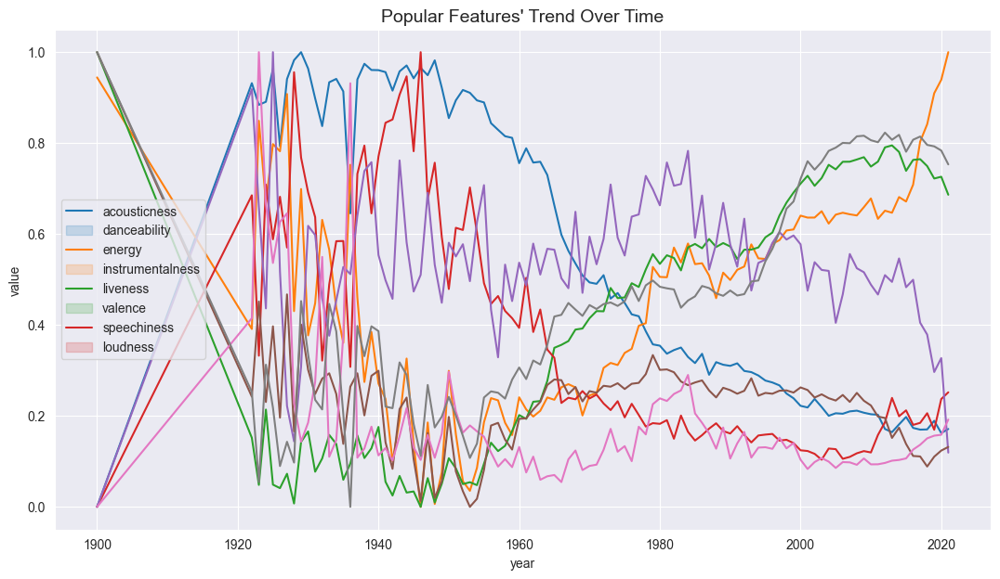

In [54]:
# Create a simple line plot for initial analysis
plt.figure(figsize=(13,7))

plt.title("Popular Features' Trend Over Time", fontdict={"fontsize": 14})


lines = ["acousticness","danceability","energy", 
         "instrumentalness", "liveness", "valence", "speechiness","loudness"]

for line in lines:
    ax = sns.lineplot(x='year', y=line, data=zdf)
    
    

plt.ylabel("value")
plt.legend(lines)

#### Convert Data to Stationary Time Series

In [55]:
zdf.index
zdf.year=pd.to_datetime(zdf.year, format='%Y')
zdf.set_index('year', inplace=True)
zdf.isna().sum()

tdf.index
#tdf.year=pd.to_datetime(tdf.year, format='%Y')
tdf.set_index('Year', inplace=True)
tdf.isna().sum()

index               0
acousticness        0
danceability        0
energy              0
instrumentalness    0
liveness            0
tempo               0
valence             0
loudness            0
speechiness         0
year                0
dtype: int64

In [56]:
df_ts = []
for column in zdf:
    #Create separate dataframes for each category
    df = zdf[column]
    df = df.to_frame()
    df_ts.append(df)
    
df_ts[0].head()

,acousticness
year,
1900-01-01,0.000000
1922-01-01,0.931860
1923-01-01,0.884164
1924-01-01,0.890879
1925-01-01,0.963252


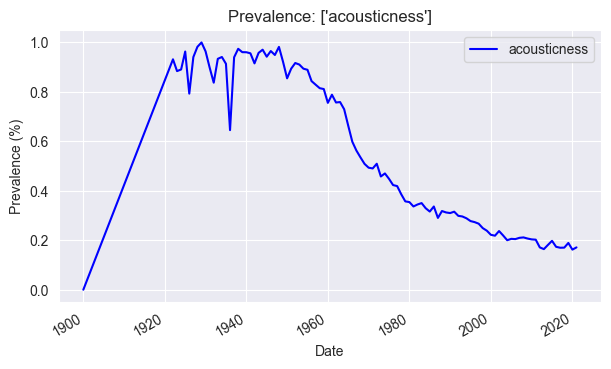

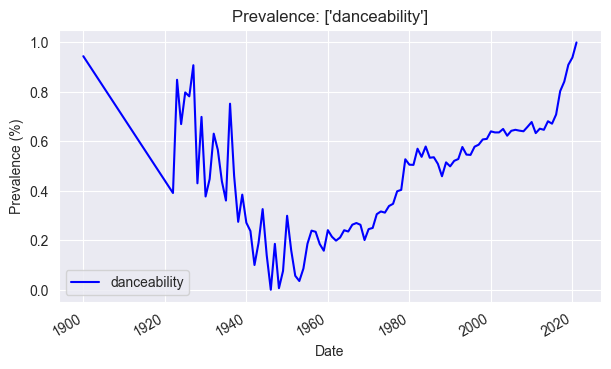

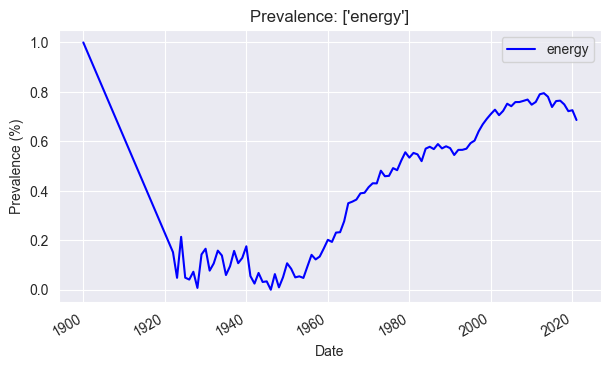

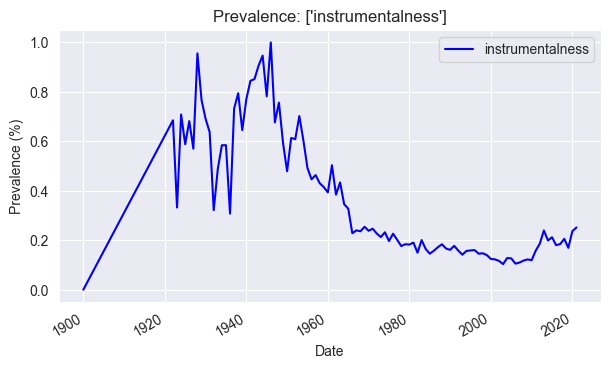

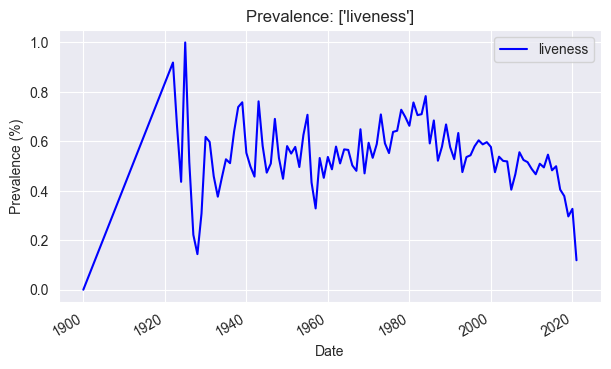

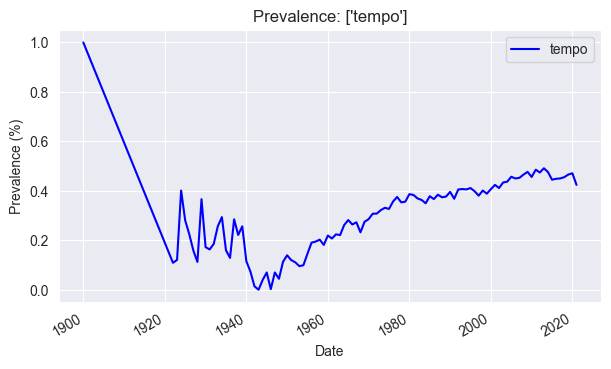

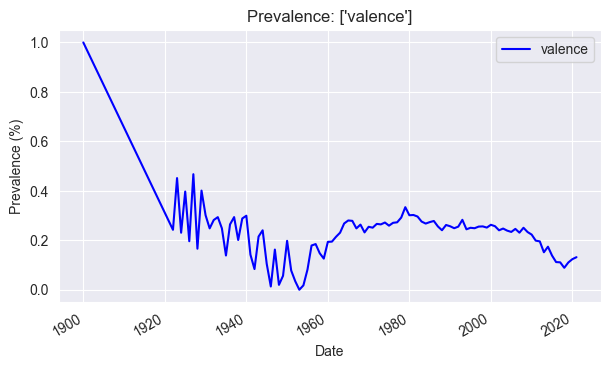

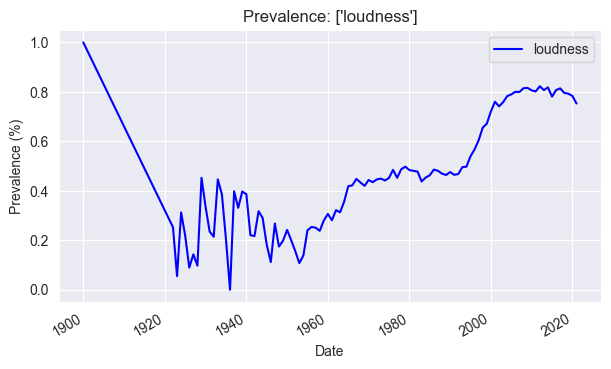

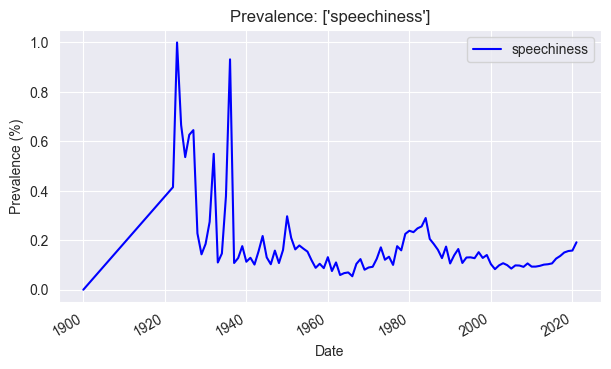

In [57]:
for i in range(len(df_ts)):
    df_ts[i].plot(figsize=(7,4), color = 'b')
    plt.title(f'Prevalence: {df_ts[i].columns.to_list()}')
    plt.xlabel('Date')
    plt.ylabel('Prevalence (%)')
    plt.legend(loc='best')
    plt.show()

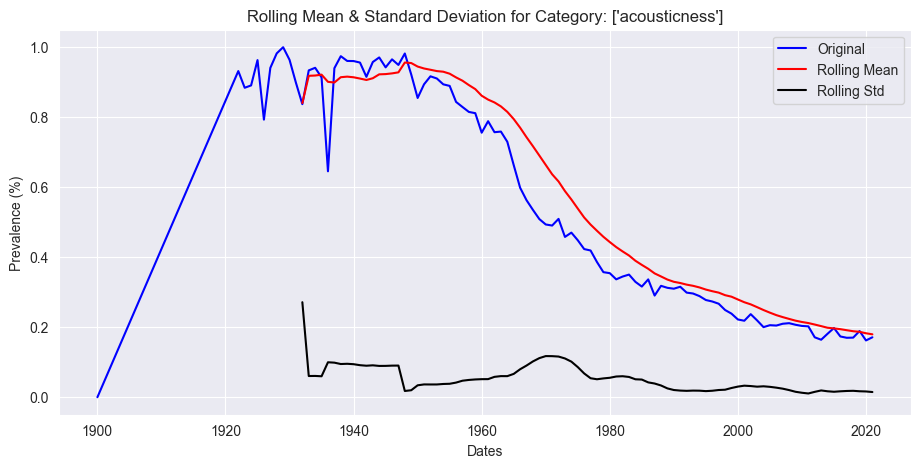

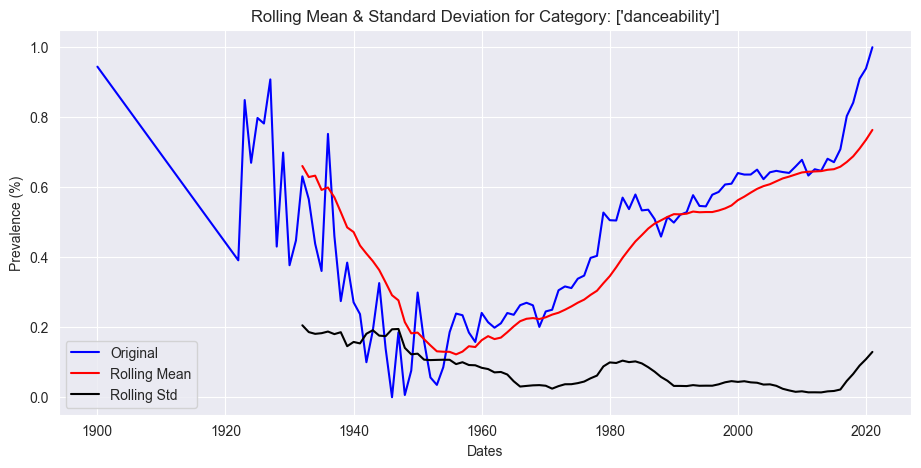

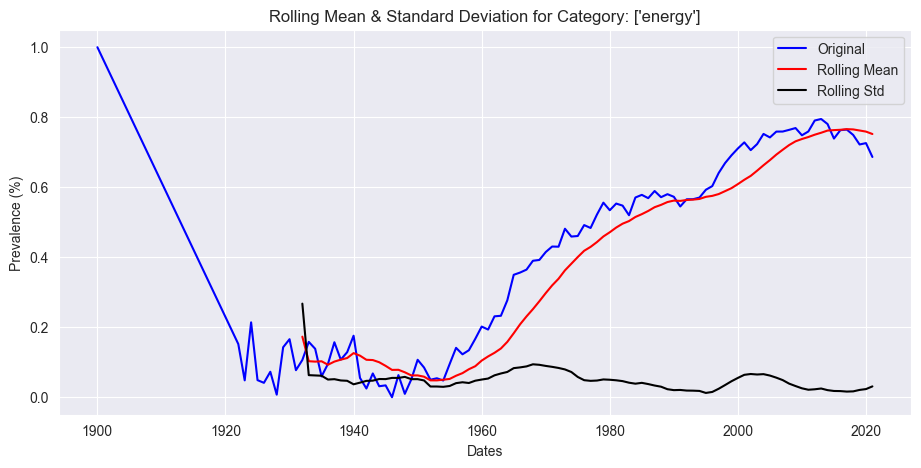

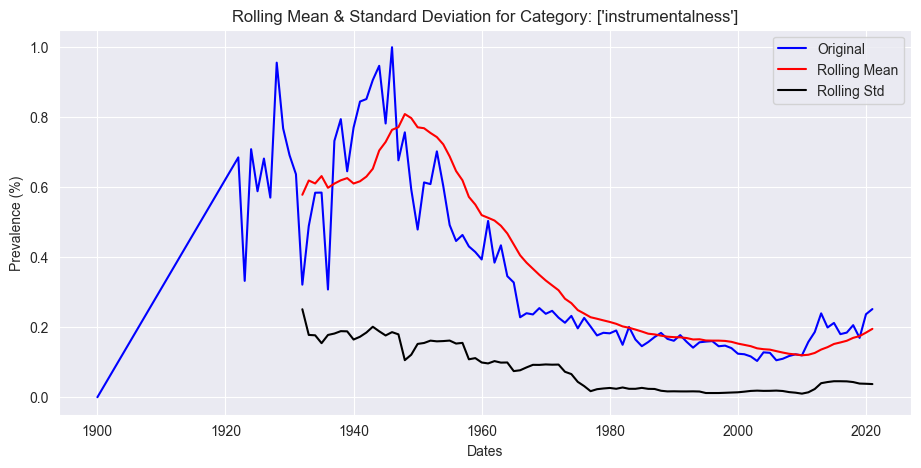

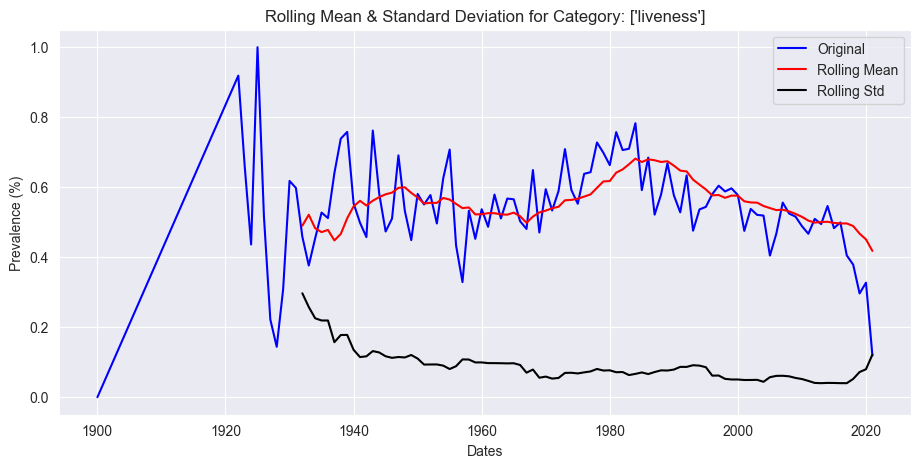

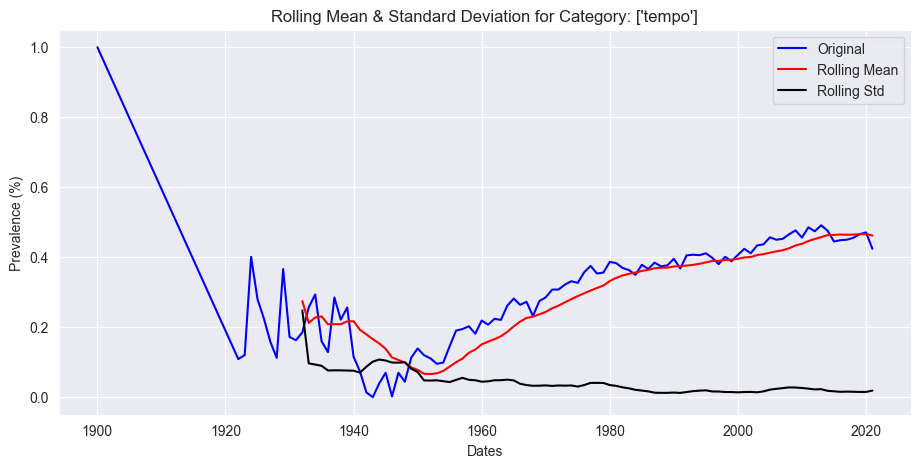

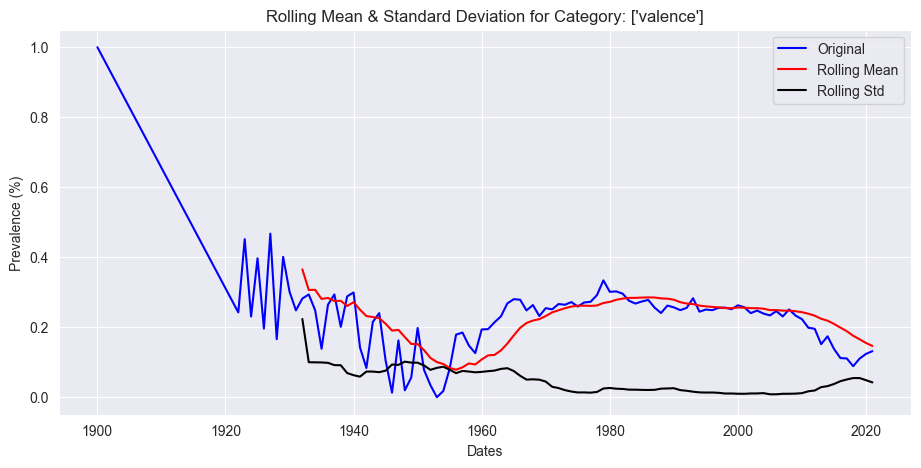

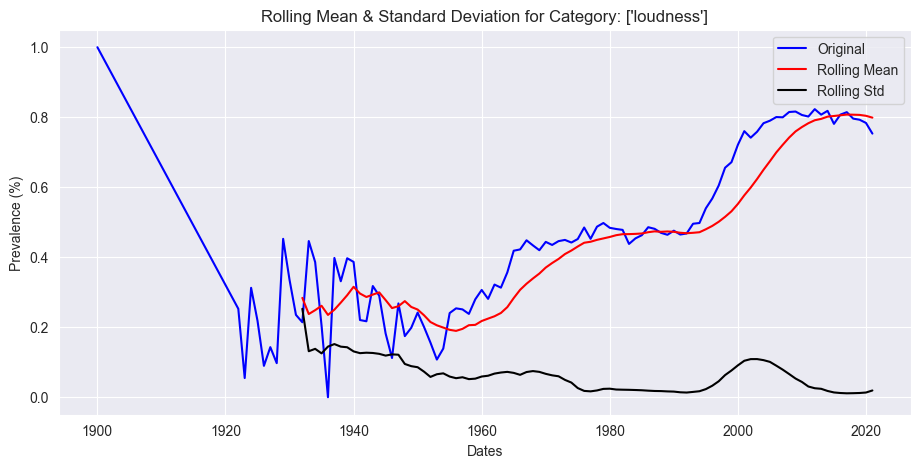

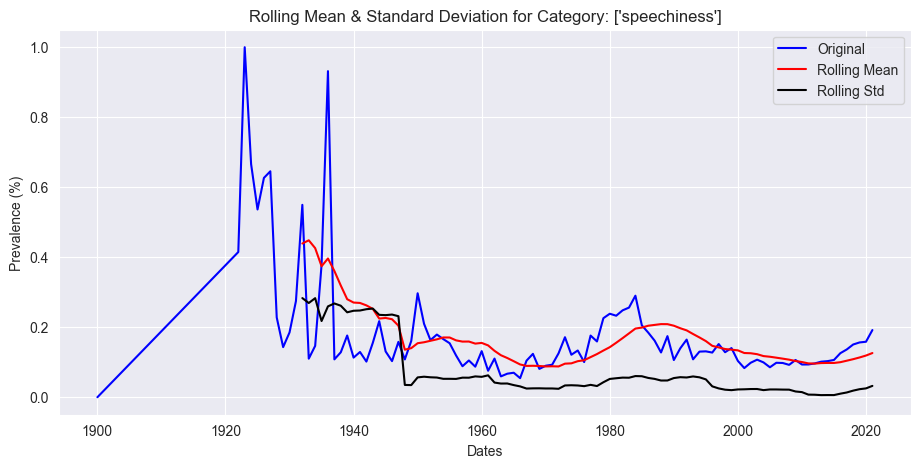

In [66]:
for i in range(len(df_ts)):
    rollingmean = df_ts[i].rolling(window = 12, center = False).mean()
    rollingstd = df_ts[i].rolling(window = 12, center = False).std()
    fig = plt.figure(figsize=(11,5))
    orig = plt.plot(df_ts[i], color='blue',label='Original')
    mean = plt.plot(rollingmean, color='red', label='Rolling Mean')
    std = plt.plot(rollingstd, color='black', label = 'Rolling Std')
    plt.xlabel('Dates')
    plt.ylabel('Prevalence (%)')
    plt.legend(loc='best')
    plt.title(f'Rolling Mean & Standard Deviation for Category: {df_ts[i].columns.to_list()}')
    plt.show()


In [68]:
acous_ts = df_ts[0] # Acousticness Prevalence Time Series

dance_ts = df_ts[1] # Loudness Prevalence Time Series

energy_ts = df_ts[2] # Energy Prevalence Time Series

inst_ts = df_ts[3]# # Valence Prevalence Time Series

live_ts = df_ts[4]# # Valence Prevalence Time Series

valence_ts = df_ts[5]# # Valence Prevalence Time Series

speech_ts = df_ts[6]# # Valence Prevalence Time Series

loudness = df_ts[7]# # Valence Prevalence Time Series

#### We can apply Arima and Sarima Here to model to see how our features fare over time

In [69]:
from statsmodels.tsa.stattools import adfuller

#Augmented Dickey–Fuller test:
print('Results of Dickey Fuller Test:')
dftest = adfuller(acous_ts, autolag='AIC')

dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
for key,value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value
    
print(dfoutput)

Results of Dickey Fuller Test:
Test Statistic                 -0.600518
p-value                         0.870865
#Lags Used                     10.000000
Number of Observations Used    90.000000
Critical Value (1%)            -3.505190
Critical Value (5%)            -2.894232
Critical Value (10%)           -2.584210
dtype: float64


<Axes: xlabel='year'>

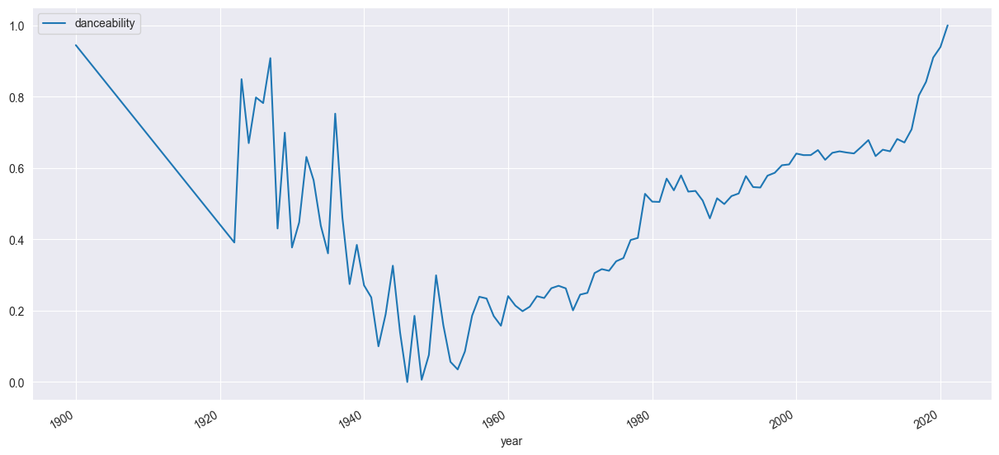

In [74]:
dance_ts.plot(figsize=(15,7))

In [76]:
import pmdarima as pm

#Use auto arima function to find the best non-seasonal and seasonal parameters to fit the model.
results = pm.auto_arima(dance_ts,information_criterion='aic', seasonal_test = 'df',
                        start_p=1,start_q=1, max_p=4, max_q=4,stepwise=True,trace=True,
                        error_action='ignore',suppress_warnings=True)
results

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0]             : AIC=-143.103, Time=0.18 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-17.909, Time=0.02 sec
 ARIMA(1,2,0)(0,0,0)[0]             : AIC=-78.291, Time=0.04 sec
 ARIMA(0,2,1)(0,0,0)[0]             : AIC=-112.517, Time=0.12 sec
 ARIMA(2,2,1)(0,0,0)[0]             : AIC=-147.158, Time=0.14 sec
 ARIMA(2,2,0)(0,0,0)[0]             : AIC=-101.725, Time=0.05 sec
 ARIMA(3,2,1)(0,0,0)[0]             : AIC=-148.603, Time=0.19 sec
 ARIMA(3,2,0)(0,0,0)[0]             : AIC=-126.803, Time=0.13 sec
 ARIMA(4,2,1)(0,0,0)[0]             : AIC=-147.106, Time=0.33 sec
 ARIMA(3,2,2)(0,0,0)[0]             : AIC=-149.248, Time=0.38 sec
 ARIMA(2,2,2)(0,0,0)[0]             : AIC=-148.338, Time=0.26 sec
 ARIMA(4,2,2)(0,0,0)[0]             : AIC=-147.240, Time=0.43 sec
 ARIMA(3,2,3)(0,0,0)[0]             : AIC=inf, Time=0.44 sec
 ARIMA(2,2,3)(0,0,0)[0]             : AIC=-148.087, Time=0.40 sec
 ARIMA(4,2,3)(0,0,0)[0]             : AI

ARIMA(order=(3, 2, 2), scoring_args={}, suppress_warnings=True)

In [84]:
def train_test(df):
    #Set training data before 2000
    train = df[:'2000']
    #Set test data starting 2000
    test = df['2000':]
    return train, test

from statsmodels.tsa.statespace.sarimax import SARIMAX

def fit_model(df,pdq,pdqs):
    # Use train_test function
    train,test = train_test(df)
    # Fit the model, give the summary information & diagnostics
    model = SARIMAX(train,order=pdq,seasonal_order=pdqs)
    results = model.fit()
    results.summary
    residuals = results.resid
    print(results.summary())
    results.plot_diagnostics(figsize=(11,8))
    plt.show();
    return train, test, results

c:\Users\Repulserator\Documents\1 SDBI\Python\Data\cnav\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Repulserator\Documents\1 SDBI\Python\Data\cnav\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Repulserator\Documents\1 SDBI\Python\Data\cnav\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                               SARIMAX Results                                
Dep. Variable:           danceability   No. Observations:                   80
Model:               SARIMAX(3, 2, 2)   Log Likelihood                  55.590
Date:                Sat, 20 May 2023   AIC                            -99.181
Time:                        11:01:21   BIC                            -85.040
Sample:                             0   HQIC                           -93.520
                                 - 80                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.3985      0.172     -8.114      0.000      -1.736      -1.061
ar.L2         -0.8728      0.217     -4.031      0.000      -1.297      -0.448
ar.L3         -0.4038      0.107     -3.766      0.0

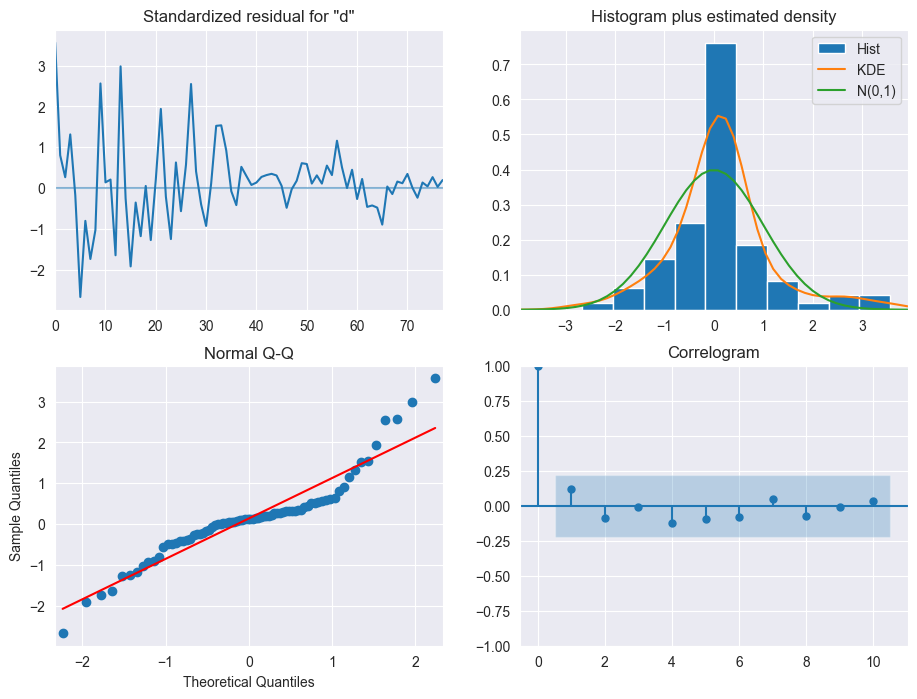

In [85]:
#Fit the SARIMA model and get results.
pdq = (3,2,2)
pdqs = (0,0,0,0)
train, test, results = fit_model(dance_ts,pdq=pdq,pdqs=pdqs)


Repeat For all

End